In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
%matplotlib inline 
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

import os
import pickle

In [60]:
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix,accuracy_score

from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC

In [3]:
os.listdir() 

['.DS_Store',
 'Emotion analysis implementation.ipynb',
 '.ipynb_checkpoints',
 'HCI-Emotion-analysis',
 'data_preprocessed_python']

Reading the files where the data is in shape of 40 * 40 * 8064

In [8]:
# reading a file
infile = open('data_preprocessed_python/s01.dat', 'rb')
new_dict = pickle.load(infile, encoding="latin1")
infile.close()
labels=[]
data=[]

for keys in new_dict:
    if(keys=='labels'):
        labels=new_dict[keys]
    else:
        data=new_dict[keys]
        
# print(data) 
# print(len(data))
# print(len(data[0]))
# print(len(data[0][0]))

In [11]:
all_channels = np.array(['b1','b2', 'b3', 'b4', 'b5', 'b6','b7', 'b8', 'b9', 'b10','b11','b12', 'b13', 'b14', 'b15', 'b16','b17', 'b18', 'b19', 'b20','b21','b22', 'b23', 'b24', 'b25', 'b26','b27', 'b28', 'b29', 'b30', 'b31', 'b32', 'hEOG', 'vEOG', 'zEMG', 'tEMG', 'GSR', 'Respiration belt', 'Plethysmograph', 'Temp'])

#convert it to dataframe
df_data = pd.DataFrame(columns = all_channels)
df_dataPerVideo = pd.DataFrame()

for i in range(0, len(data)): #video 40
    for j in range(0, len(data[i])): #channels 40
        temp = []
        for k in range(0, len(data[i][j])): #value 8064
            temp.append(data[i][j][k])
        df_dataPerVideo[all_channels[j]] = temp
    df_data= df_data.append(df_dataPerVideo,ignore_index = True)
print(df_data)

              b1        b2        b3        b4        b5        b6        b7  \
0       0.948232  0.124707 -2.216511  1.005734  5.095919  1.206457  3.866461   
1       1.653335  1.390083  2.292017  1.297927  5.000869  0.599485  3.280028   
2       3.013726  1.835099  2.746369  2.367689  4.176166  0.869299  0.656367   
3       1.495061 -1.110738 -2.364459 -0.231850  0.354056  1.974166 -3.077413   
4      -1.264836 -2.590622 -2.309528 -1.662444 -4.154098 -0.091352 -2.857734   
...          ...       ...       ...       ...       ...       ...       ...   
322555 -0.181735  1.253491  1.642762  4.294646  0.766902  1.220104  3.460047   
322556 -1.971174 -0.505393  0.009081  0.881599 -0.851881 -0.278792  2.845238   
322557 -4.438021 -3.757911 -2.944686 -3.705480 -2.498219 -3.180343  1.109236   
322558 -3.271032 -3.312243 -5.711427 -3.355575 -1.369798 -2.371437 -1.457291   
322559  2.135009  1.154261 -1.697923 -0.211496 -0.729496 -0.043667 -1.643560   

              b8        b9       b10  .

# Analyizing

## Data

In [12]:
df_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 322560 entries, 0 to 322559
Data columns (total 40 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   b1                322560 non-null  float64
 1   b2                322560 non-null  float64
 2   b3                322560 non-null  float64
 3   b4                322560 non-null  float64
 4   b5                322560 non-null  float64
 5   b6                322560 non-null  float64
 6   b7                322560 non-null  float64
 7   b8                322560 non-null  float64
 8   b9                322560 non-null  float64
 9   b10               322560 non-null  float64
 10  b11               322560 non-null  float64
 11  b12               322560 non-null  float64
 12  b13               322560 non-null  float64
 13  b14               322560 non-null  float64
 14  b15               322560 non-null  float64
 15  b16               322560 non-null  float64
 16  b17               32

In [13]:
df_data.describe()

,b1,b2,b3,b4,b5,b6,b7,b8,b9,b10,...,b31,b32,hEOG,vEOG,zEMG,tEMG,GSR,Respiration belt,Plethysmograph,Temp
count,322560.000000,322560.000000,322560.000000,322560.000000,322560.000000,322560.000000,322560.000000,322560.000000,322560.000000,322560.000000,...,322560.000000,322560.000000,322560.000000,322560.000000,322560.000000,322560.000000,322560.000000,322560.000000,322560.000000,322560.000000
mean,-0.004713,-0.000774,0.003745,-0.012562,0.000935,0.007637,-0.005837,-0.010778,-0.007802,-0.005183,...,0.003990,-0.000698,-37.667564,52.736223,3.304535,14.310923,6173.006779,228.239279,6090.351318,-0.001384
std,4.150993,4.520107,4.815842,4.855692,3.716054,3.512749,3.711093,5.725156,3.920176,2.961341,...,5.198124,4.827805,102.792355,123.904407,116.388597,209.110676,26637.455715,2413.992520,18195.217535,0.079800
min,-55.618453,-93.124517,-91.959212,-84.220310,-72.363173,-43.377086,-50.065398,-63.423521,-35.464945,-23.513457,...,-44.951613,-32.085514,-826.124125,-581.604475,-472.448264,-906.939079,-206259.394379,-9949.772550,-57088.080862,-0.392805
25%,-2.605900,-2.784948,-2.908500,-2.939662,-2.189459,-2.128342,-2.283220,-3.520577,-2.454706,-1.860388,...,-3.191095,-3.054376,-95.925584,-7.931789,-53.691714,-57.831355,455.261710,-1007.312063,-3667.068693,-0.040697
50%,0.019285,0.004319,0.001286,0.000012,0.020495,0.032343,-0.017456,0.010422,-0.029124,-0.000314,...,0.016514,-0.014811,-25.400913,43.855795,-3.753899,8.174545,6808.384820,48.658805,5085.293724,-0.000854
75%,2.617257,2.776462,2.905861,2.932940,2.203553,2.169332,2.256502,3.502149,2.420956,1.863529,...,3.216341,3.056410,21.949951,115.866485,42.778363,97.973716,16187.175343,1066.630435,15720.015645,0.039145
max,42.403042,80.722804,106.577312,64.113936,65.312598,39.614661,77.052280,51.360486,52.694432,19.734179,...,42.811241,30.887605,340.297711,671.302959,828.177669,820.471629,88203.748986,22031.898093,67879.345725,0.269155


In [17]:
df_data.nunique()

b1                  322560
b2                  322560
b3                  322560
b4                  322560
b5                  322560
b6                  322560
b7                  322560
b8                  322560
b9                  322560
b10                 322560
b11                 322560
b12                 322560
b13                 322560
b14                 322560
b15                 322560
b16                 322560
b17                 322560
b18                 322560
b19                 322560
b20                 322560
b21                 322560
b22                 322560
b23                 322560
b24                 322560
b25                 322560
b26                 322560
b27                 322560
b28                 322560
b29                 322560
b30                 322560
b31                 322560
b32                 322560
hEOG                237906
vEOG                215985
zEMG                210326
tEMG                232293
GSR                  93630
R

In [18]:
# unifying missing values and calculating number of missing values per each row 
df_data.replace('NA', np.nan, inplace=True)
df_data.replace('Missing', np.nan, inplace=True)

df_data.isna().sum()

b1                  0
b2                  0
b3                  0
b4                  0
b5                  0
b6                  0
b7                  0
b8                  0
b9                  0
b10                 0
b11                 0
b12                 0
b13                 0
b14                 0
b15                 0
b16                 0
b17                 0
b18                 0
b19                 0
b20                 0
b21                 0
b22                 0
b23                 0
b24                 0
b25                 0
b26                 0
b27                 0
b28                 0
b29                 0
b30                 0
b31                 0
b32                 0
hEOG                0
vEOG                0
zEMG                0
tEMG                0
GSR                 0
Respiration belt    0
Plethysmograph      0
Temp                0
dtype: int64

In [24]:
EEG_data = df_data[['b1','b2', 'b3', 'b4', 'b5', 'b6','b7', 'b8', 'b9', 'b10','b11','b12', 'b13', 'b14', 'b15', 'b16','b17', 'b18', 'b19', 'b20','b21','b22', 'b23', 'b24', 'b25', 'b26','b27', 'b28', 'b29', 'b30', 'b31', 'b32']]
phys_data = df_data[['hEOG', 'vEOG', 'zEMG', 'tEMG', 'GSR', 'Respiration belt', 'Plethysmograph', 'Temp']]


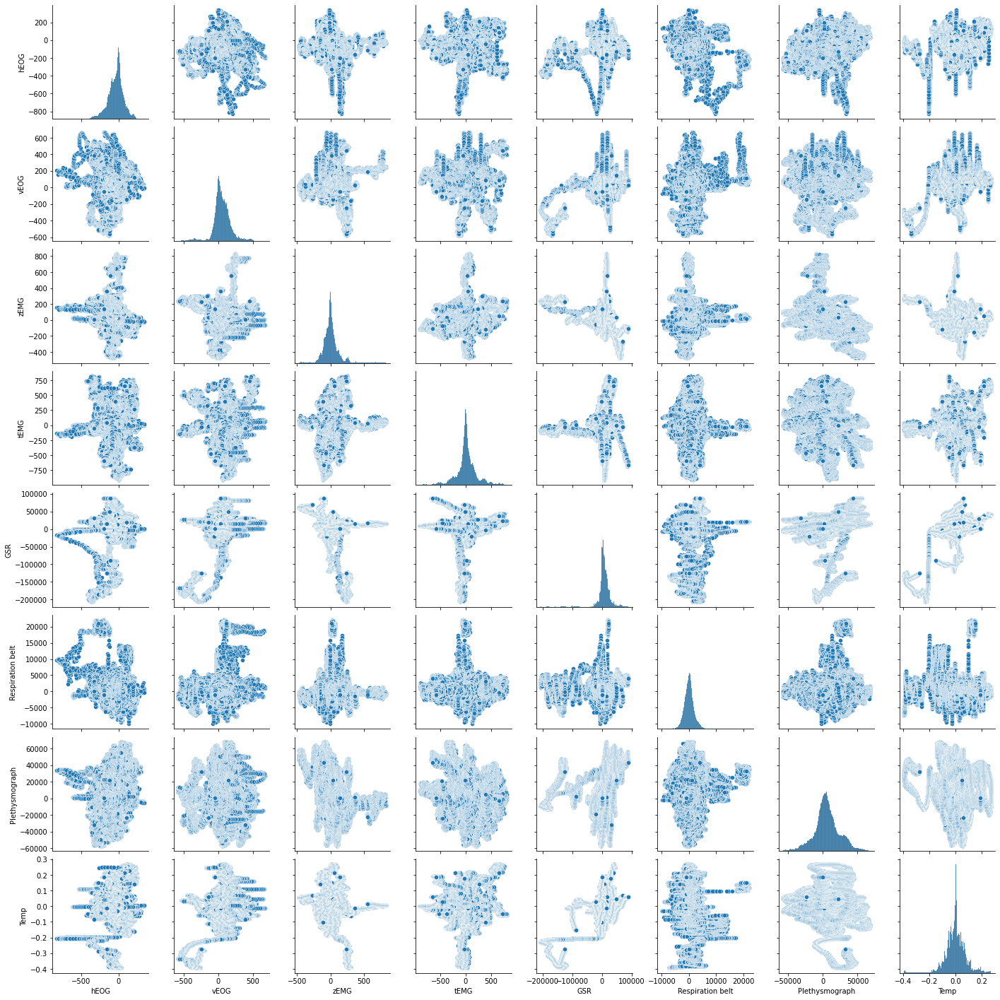

In [25]:
sns.pairplot(phys_data)

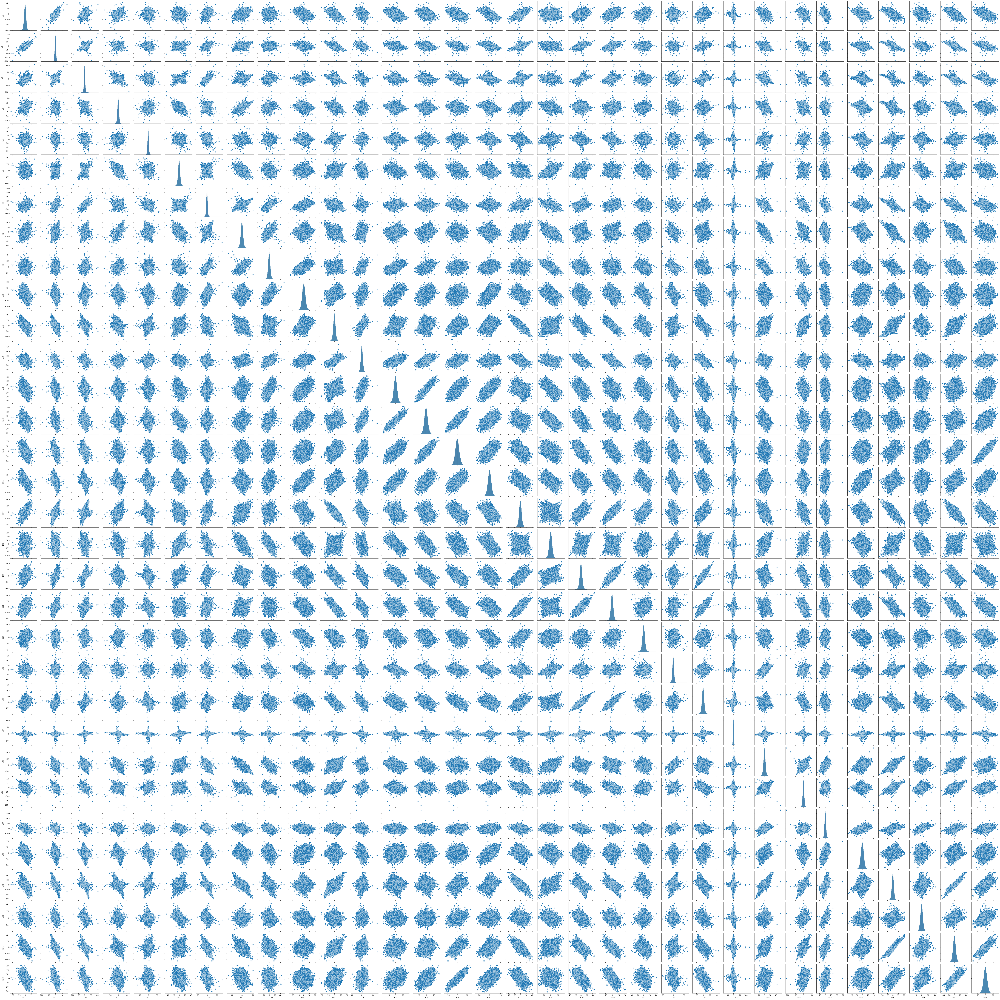

In [26]:
sns.pairplot(EEG_data)

## Labels

Arousal can range from inactive (e.g. uninterested, bored) to active (e.g. alert, excited). 


Valence ranges from unpleasant (e.g. sad, stressed) to pleasant (e.g. happy, elated).

Dominance ranges from a helpless and weak feeling (without control) to an empowered feeling (in control of everything).


In [30]:
# valence, arousal, dominance, liking
labels = np.array(labels)

# dealing with LABELS and creating a dataframe
valence = labels[:,0]
arousal = labels[:,1]
dominance = labels[:,2]
liking = labels[:,3]

labels_separated = pd.DataFrame({'valence': valence, 'arousal': arousal, 'dominance': dominance, 'liking': liking })
labels_separated.head(5)

,valence,arousal,dominance,liking
0,7.71,7.60,6.90,7.83
1,8.10,7.31,7.28,8.47
2,8.58,7.54,9.00,7.08
3,4.94,6.01,6.12,8.06
4,6.96,3.92,7.19,6.05


In [35]:
# dropped liking as we do not care about
labels_separated.drop(['liking'], axis=1, inplace=True)
labels_separated.head(5)

,valence,arousal,dominance
0,7.71,7.60,6.90
1,8.10,7.31,7.28
2,8.58,7.54,9.00
3,4.94,6.01,6.12
4,6.96,3.92,7.19


In [36]:
labels_separated.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40 entries, 0 to 39
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   valence    40 non-null     float64
 1   arousal    40 non-null     float64
 2   dominance  40 non-null     float64
dtypes: float64(3)
memory usage: 1.1 KB


In [37]:
labels_separated.describe()

,valence,arousal,dominance
count,40.00000,40.000000,40.000000
mean,5.11775,5.659750,5.902500
std,2.51712,2.179549,2.082028
min,1.36000,2.080000,2.040000
25%,2.85250,3.335000,3.565000
50%,4.56000,6.915000,6.835000
75%,7.32750,7.342500,7.302500
max,9.00000,8.150000,9.000000


<AxesSubplot:>

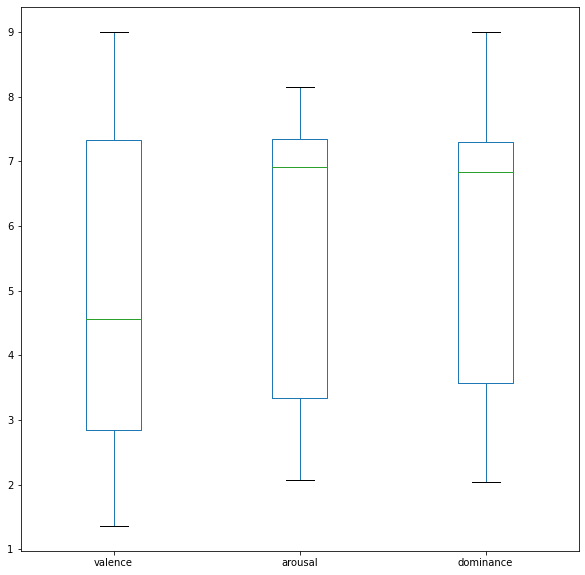

In [38]:
# Checking the skewness of each value --> to know our threshold will be median (if skewed) and mean otherwise
labels_separated.boxplot(column =['valence', 'arousal', 'dominance'], grid = False, figsize=(10,10))

In [45]:
# Setting threshold

valenceMedian = labels_separated['valence'].median()
arousalMedian = labels_separated['arousal'].median()
dominanceMedian = labels_separated['dominance'].median()

In [52]:
# Function to check if each trial has positive or negative valence
def positive_valence(trial):
    return "pos" if results.iloc[trial]['valence'] >= valenceMedian else "neg"

# Function to check if each trial has high or low arousal
def high_arousal(trial):
    return "high" if results.iloc[trial]['arousal'] >= arousalMedian else "low"

# Function to check if each trial has strong or weak dominance
def strong_dominance(trial):
    return "strong" if results.iloc[trial]['dominance'] >= dominanceMedian else "weak"

In [53]:
# Convert ratings to high/low - positive/negative - strong/weak values
labels_encoded = []
for i in range (len(results)):
    labels_encoded.append([positive_valence(i), high_arousal(i), strong_dominance(i)])
labels_encoded = np.reshape(labels_encoded, (40, 3))
labelsCategorized = pd.DataFrame(data=labels_encoded, columns=["valence", "arousal", "dominance"])


# Dataset with only Valence column
df_valence = labelsCategorized['valence']

# Dataset with only Arousal column
df_arousal = labelsCategorized['arousal']

# Dataset with only Arousal column
df_dominance = labelsCategorized['dominance']


print(labelsCategorized)

   valence arousal dominance
0      pos    high    strong
1      pos    high    strong
2      pos    high    strong
3      pos     low      weak
4      pos     low    strong
5      pos     low    strong
6      pos     low    strong
7      pos     low      weak
8      neg     low      weak
9      neg     low      weak
10     neg     low      weak
11     neg     low      weak
12     neg     low      weak
13     neg     low      weak
14     neg    high      weak
15     pos    high    strong
16     neg     low      weak
17     pos    high    strong
18     pos    high    strong
19     pos    high    strong
20     pos    high    strong
21     pos     low    strong
22     pos     low    strong
23     pos    high    strong
24     pos    high    strong
25     pos    high    strong
26     pos    high    strong
27     neg     low      weak
28     neg     low      weak
29     neg     low      weak
30     neg    high      weak
31     neg    high      weak
32     neg     low      weak
33     neg    

## Approaches: 
1. We were hesitated to take an average value to represent 1 second or take the whole vector, we tested both and we did not really find significant difference, hence for simplicity we took the **average value**
2. We thought that emotions may be maximised in the middle were also tried dividing our dataset into 3 sets of **different non-overlapping window frames** of lengths 60, 20, and 10 seconds, where for each frame all phases, that is for example frame size of 20 seconds, trying the first 20 seconds, middle 20 seconds, last 20 seconds) and taking the average value for this frame. Again we did not find significance if there was one, so for simplicity means we took all 60 seconds as one frame.

### Taking average

In [55]:
data_avgeraged = pd.DataFrame(columns=all_channels)


# taking average of each video to one value --> each 8064 sample = 1 video 
for i in range(0, len(df_data), 8064):
    data_avg = df_data.iloc[i:i+8064, :]
    avg = (data_avg.mean(axis=0))
    data_avgeraged= data_avgeraged.append(avg, ignore_index=True)
    
    
data_avgeraged.head(5)
len(data_avgeraged)

40

By now we have only one value (mean) representing each signal for each video the participants watchs

In [72]:
# Using KNN classifier with K-NN
# TRY FIRST VALENCE

# split the data into train and test
dataYValence = df_valence
dataX = data_avgeraged

x_train, x_test, y_train, y_test = train_test_split(dataX, dataYValence, test_size=0.2, stratify=dataYValence)

# apply standardization on numerical features
sc = StandardScaler()
standX_train = sc.fit_transform(x_train)
standX_test = sc.transform(x_test)
# Training and Predictions
classifier = KNeighborsClassifier(n_neighbors=5)
classifier.fit(standX_train, y_train)

# make predictions on our test data
y_pred = classifier.predict(standX_test)

# # #Evaluating the Algorithm
# print(confusion_matrix(y_test, y_pred))
# print(classification_report(y_test, y_pred))
print("Valence accuracy: ", accuracy_score(y_test,y_pred)*100)






# TRY THEN AROUSAL

# split the data into train and test
dataArousal = df_arousal
dataX = data_avgeraged

x_train, x_test, y_train, y_test = train_test_split(dataX, dataArousal, test_size=0.2, stratify=dataArousal)

# apply standardization on numerical features
sc = StandardScaler()
standX_train = sc.fit_transform(x_train)
standX_test = sc.transform(x_test)
# Training and Predictions
classifier = KNeighborsClassifier(n_neighbors=5)
classifier.fit(standX_train, y_train)

# make predictions on our test data
y_pred = classifier.predict(standX_test)

# # #Evaluating the Algorithm
# print(confusion_matrix(y_test, y_pred))
# print(classification_report(y_test, y_pred))
print("Arousal accuracy: ", accuracy_score(y_test,y_pred)*100)



# TRY THEN DOMINANCE

# split the data into train and test
dataDominance = df_dominance
dataX = data_avgeraged

x_train, x_test, y_train, y_test = train_test_split(dataX, dataDominance, test_size=0.2, stratify=dataArousal)

# apply standardization on numerical features
sc = StandardScaler()
standX_train = sc.fit_transform(x_train)
standX_test = sc.transform(x_test)
# Training and Predictions
classifier = KNeighborsClassifier(n_neighbors=5)
classifier.fit(standX_train, y_train)

# make predictions on our test data
y_pred = classifier.predict(standX_test)

# # #Evaluating the Algorithm
# print(confusion_matrix(y_test, y_pred))
# print(classification_report(y_test, y_pred))
print("Dominance accuracy: ", accuracy_score(y_test,y_pred)*100)

Valence accuracy:  37.5
Arousal accuracy:  62.5
Dominance accuracy:  37.5
